# Autotalker Data Analysis Tutorial

- **Creator**: Sebastian Birk (<sebastian.birk@helmholtz-munich.de>).
- **Affiliation:** Helmholtz Munich, Institute of Computational Biology (ICB), Talavera-López Lab
- **Date of Creation:** 22.01.2023
- **Date of Last Modification:** 08.05.2023

- In order to run this notebook, a trained model needs to be stored under f"../artifacts/{dataset}/models/{load_timestamp}/{model_label}".

## 1. Setup

### 1.1 Import Libraries

In [ ]:
%load_ext autoreload
%autoreload 2

In [ ]:
import sys
sys.path.append("../../autotalker")
sys.path.append("../utils")

In [ ]:
import argparse
import os
import random
import warnings
from datetime import datetime

import anndata as ad
import matplotlib
import matplotlib.pyplot as plt
import mlflow
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.sparse as sp
import seaborn as sns
import squidpy as sq
import torch
from matplotlib import gridspec
from matplotlib.pyplot import rc_context

from autotalker.models import Autotalker
from autotalker.utils import (add_gps_from_gp_dict_to_adata,
                              aggregate_obsp_matrix_per_cell_type,
                              create_cell_type_chord_plot_from_df,
                              extract_gp_dict_from_mebocost_es_interactions,
                              extract_gp_dict_from_nichenet_ligand_target_mx,
                              extract_gp_dict_from_omnipath_lr_interactions,
                              filter_and_combine_gp_dict_gps,
                              get_unique_genes_from_gp_dict)

from color_utils import (latent_cluster_colors,
                         seqfish_mouse_organogenesis_cell_type_colors,
                         starmap_plus_mouse_cns_cell_type_colors)
from analysis_utils import (add_cell_type_latent_cluster_emphasis,
                            add_sub_cell_type,
                            get_cat_gp_score_gene_expr_summary,                           
                            get_differential_analysis_results,
                            plot_cat_gp_score_gene_expr_summary,
                            cluster_and_plot_cell_type_latent_clusters,
                            plot_physical_latent_for_cell_types,
                            store_top_gps_summary)

### 1.2 Define Parameters

In [ ]:
## Model
# Model to be loaded
dataset = "seqfish_mouse_organogenesis_imputed"
load_timestamp = "08052023_055422"
model_label = "reference"
run_number = 1 # only required if model_label == sample_integration_method_benchmarking

# AnnData keys
counts_key = "log_normalized_counts" # raw counts not available
cell_type_key = "celltype_mapped_refined"
sub_cell_type_key = "sub_cell_type"
adj_key = "spatial_connectivities"
spatial_key = "spatial"
gp_names_key = "autotalker_gp_names"
active_gp_names_key = "autotalker_active_gp_names"
gp_targets_mask_key = "autotalker_gp_targets"
gp_sources_mask_key = "autotalker_gp_sources"
latent_key = "autotalker_latent"
condition_key = "batch"
sample_key = "sample"
query_enriched_cell_type_key = "autotalker_query_enriched_cell_types"
query_enriched_latent_cluster_key = "autotalker_query_enriched_latent_clusters"
mapping_entity_key = "mapping_entity"

# Benchmarking
spatial_knng_key = "autotalker_spatial_knng"
latent_knng_key = "autotalker_latent"

# Analysis
enriched_query_cell_type_prop_thresh = 5
enriched_query_latent_cluster_prop_thresh = 2.5
latent_leiden_resolution = 0.3
latent_cluster_key = f"latent_leiden_{str(latent_leiden_resolution)}"
denovo_cell_type_differential_gp_scores_key = "autotalker_denovo_cell_type_differential_gp_scores"
cell_type_differential_gp_scores_key = "autotalker_cell_type_differential_gp_scores"
query_enriched_cell_type_differential_gp_scores_key = "autotalker_query_enriched_latent_cluster_differential_gp_scores"
latent_cluster_differential_gp_scores_key = "autotalker_latent_cluster_differential_gp_scores"
query_enriched_latent_cluster_differential_gp_scores_key = "autotalker_query_enriched_latent_cluster_differential_gp_scores"
n_top_up_gps = 3
n_top_down_gps = 3
n_top_genes_per_gp = 3

## Others
random_seed = 0

### 1.3 Run Notebook Setup

In [ ]:
if dataset == "seqfish_mouse_organogenesis_imputed":
    cell_type_colors = seqfish_mouse_organogenesis_cell_type_colors
    dataset_str = "seqFISH Mouse Organogenesis Imputed"
elif dataset == "starmap_plus_mouse_cns":
    cell_type_colors = starmap_plus_mouse_cns_cell_type_colors
    dataset_str = "STARmap PLUS Mouse Central Nervous System"

In [ ]:
sc.set_figure_params(figsize=(6, 6))
sns.set_style("whitegrid", {'axes.grid' : False})

In [ ]:
# Ignore future warnings and user warnings
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=UserWarning)
warnings.simplefilter(action="ignore", category=RuntimeWarning)

In [ ]:
# Get time of notebook execution for timestamping saved artifacts
now = datetime.now()
if load_timestamp is not None:
    current_timestamp = load_timestamp
else:
    current_timestamp = now.strftime("%d%m%Y_%H%M%S")

### 1.4 Configure Paths and Create Directories

In [ ]:
# Define paths
figure_folder_path = f"../figures/{dataset}/analysis/{current_timestamp}"
model_artifacts_folder_path = f"../artifacts/{dataset}/models/{load_timestamp}"
gp_data_folder_path = "../datasets/gp_data" # gene program data
srt_data_folder_path = "../datasets/srt_data" # spatially resolved transcriptomics data
srt_data_gold_folder_path = f"{srt_data_folder_path}/gold"

# Create required directories
os.makedirs(figure_folder_path, exist_ok=True)
os.makedirs(model_artifacts_folder_path, exist_ok=True)

## 2. Model

### 2.1 Load Model

In [ ]:
if model_label == "sample_integration_method_benchmarking":
    model_dir_path = f"{model_artifacts_folder_path}/{model_label}/run{run_number}"
else:
    model_dir_path = f"{model_artifacts_folder_path}/{model_label}"

# Load trained model
model = Autotalker.load(dir_path=model_dir_path,
                        adata=None,
                        adata_file_name=f"{dataset}_{model_label}.h5ad",
                        gp_names_key=gp_names_key)

### 2.2 Retrieve GP Summary

In [ ]:
# Check number of active gene programs
active_gps = model.get_active_gps()
print(f"Number of total gene programs: {len(model.adata.uns[gp_names_key])}.")
print(f"Number of active gene programs: {len(active_gps)}.")

In [ ]:
gp_summary_df = model.get_gp_summary()
gp_summary_df[gp_summary_df["gp_active"] == True][0:20]

## 3. Analysis

### 3.1 Dataset Overview

In [ ]:
# Plot UMAP with batch annotations
fig = sc.pl.umap(model.adata,
                 color=[condition_key],
                 size=320000/len(model.adata),
                 return_fig=True)
fig.set_size_inches(15, 10)
plt.title(f"{dataset_str}: Autotalker Latent Batch Annotations", size=20, pad=15)

In [ ]:
# Plot UMAP with cell type annotations
fig = sc.pl.umap(model.adata,
                 #groups="Erythroid",
                 #groups="Allantois",
                 color=[cell_type_key],
                 palette=cell_type_colors,
                 legend_fontsize=12,
                 size=240000/len(model.adata),
                 return_fig=True)
fig.set_figheight(10)
fig.set_figwidth(10)
fig.set_size_inches(15, 10)
plt.title(f"{dataset_str}: Autotalker Cell Type Annotations", size=20, pad=15)

In [ ]:
# Plot UMAP with cell type annotations
fig = sc.pl.umap(model.adata,
                 #groups="Allantois",
                 color=[mapping_entity_key],
                 legend_fontsize=12,
                 size=240000/len(model.adata),
                 return_fig=True)
fig.set_figheight(10)
fig.set_figwidth(10)
fig.set_size_inches(15, 10)
plt.title(f"{dataset_str}: Autotalker Mapping Entity Annotations", size=20, pad=15)

### 3.2 Cell Type Analysis

#### 3.2.1 Cardiomyocytes

In [ ]:
cell_type = "Cardiomyocytes"
cell_type_fmt = cell_type.replace('/', '_').lower()
cell_type_latent_resolution = 1.0
cell_type_latent_cluster_key = f"{cell_type_fmt}_latent_leiden_{cell_type_latent_resolution}"
cell_type_latent_cluster_emphasis_key = f"{cell_type_latent_cluster_key}_emphasis"
cell_type_differential_gp_scores_key = f"{cell_type}_differential_gp_scores"

In [ ]:
plot_physical_latent_for_cell_types(adata=model.adata,
                                    cell_types=[cell_type],
                                    sample_key=sample_key,
                                    cell_type_key=cell_type_key,
                                    cell_type_colors=seqfish_mouse_organogenesis_cell_type_colors,
                                    figure_folder_path=figure_folder_path,
                                    save_fig=False)

In [ ]:
top_unique_gps = get_differential_analysis_results(
    analysis_label=cell_type_fmt,
    model=model,
    adata=model.adata,
    cell_type_key=cell_type_key,
    cell_type_colors=cell_type_colors,
    cat_key=cell_type_key,
    selected_cats=[cell_type],
    differential_gp_scores_key=cell_type_differential_gp_scores_key,
    comparison_cats="rest",
    plot_category=cell_type_key,
    plot_group=cell_type,
    selected_gps=None,
    n_top_up_gps=10,
    n_top_down_gps=10,
    feature_spaces=["latent"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
    save_figs=False,
    random_seed=random_seed)

top_gps_summary_df = store_top_gps_summary(model=model,
                                           top_gps=top_unique_gps,
                                           file_path=f"{model_artifacts_folder_path}/{cell_type_fmt}_gp_summary.csv")
display(top_gps_summary_df)

In [ ]:
# Compute latent Leiden clustering with cell-type-specific resolution
sc.tl.leiden(adata=model.adata,
             resolution=cell_type_latent_resolution,
             random_state=random_seed,
             key_added=cell_type_latent_cluster_key,
             neighbors_key=latent_knng_key)

# Filter for cell type
cell_type_adata = model.adata[model.adata.obs[cell_type_key] == cell_type]

# Only keep latent clusters for cell type and set rest to NaN
model.adata.obs[cell_type_latent_cluster_key] = np.nan
model.adata.obs.loc[model.adata.obs[cell_type_key] == cell_type,
                    cell_type_latent_cluster_key] = cell_type_adata.obs[cell_type_latent_cluster_key]

In [ ]:
plot_latent_physical_for_cell_type_latent_clusters(adata=model.adata,
                                                   cell_type=cell_type,
                                                   save_fig=False)

In [ ]:
# Retrieve all latent clusters with cells of the given cell type
cell_type_latent_clusters = [cell_type_latent_cluster for cell_type_latent_cluster 
                             in model.adata.obs[cell_type_latent_cluster_key].unique().tolist()
                             if str(cell_type_latent_cluster) != "nan"]

# Define latent clusters of interest according to visualization
cell_type_latent_clusters_of_interest = ["2", "25", "43"]

# Add column with sub cell types
model.adata.obs[sub_cell_type_key] = model.adata.obs.apply(lambda row: add_sub_cell_type(row, cell_type=cell_type), axis=1)
model.adata.obs[sub_cell_type_key] = model.adata.obs[sub_cell_type_key].astype("category")

# Squidpy nhood enrichment is sorted alphabetically
sub_cell_types = model.adata.obs[sub_cell_type_key].unique().tolist()
sub_cell_types.sort()

sq.gr.nhood_enrichment(model.adata, cluster_key=sub_cell_type_key)

cell_type_sub_cell_types_idx = []
for i, sub_cell_type in enumerate(sub_cell_types):
    if cell_type in sub_cell_type:
        cell_type_sub_cell_types_idx.append(i)

        # Retrieve cell type latent cluster neighborhood enrichments
enrichment_dict = {f"{sub_cell_types[cell_type_sub_cell_types_idx[i]]}":{
    sub_cell_type: zscore for zscore, sub_cell_type in sorted(
        zip(model.adata.uns[f"{sub_cell_type_key}_nhood_enrichment"]["zscore"][cell_type_sub_cell_types_idx[i]], sub_cell_types), reverse=True)} for i in range(len(cell_type_sub_cell_types_idx))}

enrichment_df = pd.DataFrame(enrichment_dict)

#### 3.2.1 Latent Cluster 2

In [ ]:
selected_cats = ["2"]
comparison_cats = list(set(cell_type_latent_clusters_of_interest) - set(selected_cats))
latent_cluster_differential_gp_scores_key = f"autotalker_latent_cluster_{selected_cats[0]}_differential_gp_scores"

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

top_unique_gps = get_differential_analysis_results(
    analysis_label=f"{cell_type}_latent_cluster",
    model=model,
    adata=model.adata,
    cat_key=cell_type_latent_cluster_key,
    selected_cats=selected_cats,
    differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
    comparison_cats=comparison_cats,
    plot_category=cell_type_latent_cluster_emphasis_key,
    plot_group=[x for x in model.adata.obs[cell_type_latent_cluster_emphasis_key].unique().tolist() if str(x) != "nan"],
    selected_gps=None,
    n_top_up_gps=10,
    n_top_down_gps=10,
    feature_spaces=["latent"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
    save_figs=False)

top_gps_summary_df = store_top_gps_summary(model=model,
                                           top_gps=top_unique_gps,
                                           file_name=f"{cell_type_fmt}_cluster{selected_cats[0]}_gp_summary.csv")
display(top_gps_summary_df)

#### 3.2.2 Latent Cluster 25

In [ ]:
selected_cats = ["25"]
comparison_cats = list(set(cell_type_latent_clusters_of_interest) - set(selected_cats))
latent_cluster_differential_gp_scores_key = f"autotalker_latent_cluster_{selected_cats[0]}_differential_gp_scores"

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

top_unique_gps = get_differential_analysis_results(
    analysis_label=f"{cell_type}_latent_cluster",
    model=model,
    adata=model.adata,
    cat_key=cell_type_latent_cluster_key,
    selected_cats=selected_cats,
    differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
    comparison_cats=comparison_cats,
    plot_category=cell_type_latent_cluster_emphasis_key,
    plot_group=[x for x in model.adata.obs[cell_type_latent_cluster_emphasis_key].unique().tolist() if str(x) != "nan"],
    selected_gps=None,
    n_top_up_gps=10,
    n_top_down_gps=10,
    feature_spaces=["latent"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
    save_figs=False)

top_gps_summary_df = store_top_gps_summary(model=model,
                                           top_gps=top_unique_gps,
                                           file_name=f"{cell_type_fmt}_cluster{selected_cats[0]}_gp_summary.csv")
display(top_gps_summary_df)

#### 3.2.3 Latent Cluster 43

In [ ]:
selected_cats = ["43"]
comparison_cats = list(set(cell_type_latent_clusters_of_interest) - set(selected_cats))
latent_cluster_differential_gp_scores_key = f"autotalker_latent_cluster_{selected_cats[0]}_differential_gp_scores"

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

top_unique_gps = get_differential_analysis_results(
    analysis_label=f"{cell_type}_latent_cluster",
    model=model,
    adata=model.adata,
    cat_key=cell_type_latent_cluster_key,
    selected_cats=selected_cats,
    differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
    comparison_cats=comparison_cats,
    plot_category=cell_type_latent_cluster_emphasis_key,
    plot_group=[x for x in model.adata.obs[cell_type_latent_cluster_emphasis_key].unique().tolist() if str(x) != "nan"],
    selected_gps=None,
    n_top_up_gps=10,
    n_top_down_gps=10,
    feature_spaces=["latent"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
    save_figs=False)

top_gps_summary_df = store_top_gps_summary(model=model,
                                           top_gps=top_unique_gps,
                                           file_name=f"{cell_type_fmt}_cluster{selected_cats[0]}_gp_summary.csv")
display(top_gps_summary_df)

In [ ]:
top_gps = [model.adata.uns[f"autotalker_latent_cluster_{latent_cluster}_differential_gp_scores"]["gene_program"][:n_top_up_gps].tolist() + 
           model.adata.uns[f"autotalker_latent_cluster_{latent_cluster}_differential_gp_scores"]["gene_program"][-n_top_down_gps:].tolist()
           for latent_cluster in cell_type_latent_clusters_of_interest]

top_gps = [gp for gp_list in top_gps for gp in gp_list]

for gp in top_gps:
    cell_type_adata.obs[gp] = model.adata.obs.loc[model.adata.obs[cell_type_latent_cluster_key].notnull(), gp]

In [ ]:
fig = sc.pl.dotplot(cell_type_adata,
            top_gps,
            groupby=cell_type_latent_cluster_key,
            dendrogram=True, 
            title="Mixed Mesenchymal Mesoderm Latent Clusters Differential GP Scores",
            swap_axes=True,
            ax=ax1,
            return_fig=True)
title = fig.suptitle(t=f"asd",
                     y=0.96,
                     x=0.55,
                     fontsize=20)
spec = gridspec.GridSpec(ncols=2,
                         nrows=1,
                         width_ratios=[1, 1],
                         height_ratios=[1])
ax1 = fig.add_subplot(spec[0])
ax2 = fig.add_subplot(spec[0])

#ax2 = sns.heatmap(enrichment_df, annot=True, fmt=".2f", cmap="viridis", ax=ax2)
plt.show()

In [ ]:
axs = sc.pl.heatmap(cell_type_adata,
                   top_gps,
                   groupby=cell_type_latent_cluster_key,
                   cmap="viridis",
                   dendrogram=True,
                   swap_axes=True,
                   figsize=(12, 12),
                   show=False)
fig = axs["heatmap_ax"].get_figure()
fig.subplots_adjust(left=0.4)
spec = matplotlib.gridspec.GridSpec(ncols=2, nrows=1, right=2.2)
ax2 = fig.add_subplot(spec[1])
sns.heatmap(enrichment_df, annot=True, fmt=".2f", cmap="viridis", ax=ax2)
ax2.set_title("Neighborhood enrichments")

In [ ]:
fig = sc.pl.dotplot(cell_type_adata,
                    top_gps,
                    groupby=cell_type_latent_cluster_key,
                    dendrogram=True, 
                    title=f"{cell_type_fmt} Latent Clusters Differential GP Scores",
                    cmap="magma",
                    swap_axes=True,
                    return_fig=True)
# Save and display plot
#if save_figs:
#    fig.savefig(f"{figure_folder_path}/{analysis_label}_differential_gp_scores.png")
fig.show()

In [ ]:
# Retrieve summary information for top gene programs
cell_type_gp_df = gp_summary_df[gp_summary_df["gp_name"].isin(top_gps)][[
    "gp_name",
    "n_source_genes",
    "n_non_zero_source_genes",
    "n_target_genes",
    "n_non_zero_target_genes",
    "gp_source_genes",
    "gp_target_genes",
    "gp_source_genes_weights_sign_corrected",
    "gp_target_genes_weights_sign_corrected",
    "gp_source_genes_importances",
    "gp_target_genes_importances"]]

# Write to disk
cell_type_gp_df.to_csv(f"{model_artifacts_folder_path}/cell_type_gp_df.csv")
display(cell_type_gp_df)

#### 3.2.4 Cardiomyocytes vs Endothelium

Cardiomyocytes are spatially and morphologically distinct from other cell types, endothelium is interspersed and spread across the entire embryo space.

In [ ]:
plot_physical_latent_for_cell_types(adata=model.adata,
                                    cell_types=["Cardiomyocytes", "Endothelium"],
                                    save_fig=True)

### 3.3 Mixed Mesenchymal Mesoderm

"mixed mesenchymal mesoderm, represent 
a cell state rather than a defined cell type. Mesenchyme represents  a  state  in  which  cells  express  markers  characteristic  of  migratory   cells loosely dispersed within an extracellular matrix56. This strong  overriding transcriptional signature of mesenchyme, irrespective of  location,  makes  it  challenging  to  distinguish  which  cell  types  this   mixed  mesenchymal  mesoderm  population  represents  using  clas- sical scRNA-seq data"

We can identify distinct subpopulations that are spatially defined.

In [ ]:
cell_type = "Mixed mesenchymal mesoderm"
cell_type_fmt = cell_type.replace(' ', '_').lower()
cell_type_latent_resolution = 0.5 # 0.5
cell_type_latent_cluster_key = f"{cell_type_fmt}_latent_leiden_{cell_type_latent_resolution}"
cell_type_latent_cluster_emphasis_key = f"{cell_type_latent_cluster_key}_emphasis"
cell_type_differential_gp_scores_key = f"{cell_type}_differential_gp_scores"

In [ ]:
plot_physical_latent_for_cell_types(adata=model.adata,
                                    cell_types=["Mixed mesenchymal mesoderm"],
                                    save_fig=False)

In [ ]:
top_unique_gps = get_differential_analysis_results(
    analysis_label=cell_type_fmt,
    model=model,
    adata=model.adata,
    cat_key=cell_type_key,
    selected_cats=[cell_type],
    differential_gp_scores_key=cell_type_differential_gp_scores_key,
    comparison_cats="rest",
    plot_category=cell_type_key,
    plot_group=cell_type,
    selected_gps=None,
    n_top_up_gps=10,
    n_top_down_gps=10,
    feature_spaces=["latent"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
    save_figs=False)

top_gps_summary_df = store_top_gps_summary(model=model,
                                           top_gps=top_unique_gps,
                                           file_name=f"{cell_type_fmt}_gp_summary.csv")
display(top_gps_summary_df)

In [ ]:
# Compute latent Leiden clustering with cell-type-specific resolution
sc.tl.leiden(adata=model.adata,
             resolution=cell_type_latent_resolution,
             random_state=random_seed,
             key_added=cell_type_latent_cluster_key,
             neighbors_key=latent_knng_key)

# Filter for cell type
cell_type_adata = model.adata[model.adata.obs[cell_type_key] == cell_type]

# Only keep latent clusters for cell type and set rest to NaN
model.adata.obs[cell_type_latent_cluster_key] = np.nan
model.adata.obs.loc[model.adata.obs[cell_type_key] == cell_type,
                    cell_type_latent_cluster_key] = cell_type_adata.obs[cell_type_latent_cluster_key]

In [ ]:
plot_latent_physical_for_cell_type_latent_clusters(adata=model.adata,
                                                   cell_type=cell_type,
                                                   save_fig=False)

In [ ]:
fig = sc.pl.umap(
    model.adata,
    color=f"{cell_type_fmt}_latent_leiden_{cell_type_latent_resolution}",
    palette=latent_cluster_colors,
    groups="11",
    size=2560000/len(model.adata),
    return_fig=True)
fig.set_size_inches(15, 10)

In [ ]:
# Retrieve all latent clusters with cells of the given cell type
cell_type_latent_clusters = [cell_type_latent_cluster for cell_type_latent_cluster 
                             in model.adata.obs[cell_type_latent_cluster_key].unique().tolist()
                             if str(cell_type_latent_cluster) != "nan"]

# Define latent clusters of interest according to visualization
cell_type_latent_clusters_of_interest = ["1", "22", "16", "13", "20", "24"]

# Add column with sub cell types
model.adata.obs[sub_cell_type_key] = model.adata.obs.apply(lambda row: add_sub_cell_type(row, cell_type=cell_type), axis=1)
model.adata.obs[sub_cell_type_key] = model.adata.obs[sub_cell_type_key].astype("category")

# Squidpy nhood enrichment is sorted alphabetically
sub_cell_types = model.adata.obs[sub_cell_type_key].unique().tolist()
sub_cell_types.sort()

sq.gr.nhood_enrichment(model.adata, cluster_key=sub_cell_type_key)

cell_type_sub_cell_types_idx = []
for i, sub_cell_type in enumerate(sub_cell_types):
    if cell_type in sub_cell_type:
        cell_type_sub_cell_types_idx.append(i)

        # Retrieve cell type latent cluster neighborhood enrichments
enrichment_dict = {f"{sub_cell_types[cell_type_sub_cell_types_idx[i]]}":{
    sub_cell_type: zscore for zscore, sub_cell_type in sorted(
        zip(model.adata.uns[f"{sub_cell_type_key}_nhood_enrichment"]["zscore"][cell_type_sub_cell_types_idx[i]], sub_cell_types), reverse=True)} for i in range(len(cell_type_sub_cell_types_idx))}

enrichment_df = pd.DataFrame(enrichment_dict)

#### 3.3.1 Latent Cluster 1

In [ ]:
selected_cats = ["1"]
comparison_cats = list(set(cell_type_latent_clusters_of_interest) - set(selected_cats))
latent_cluster_differential_gp_scores_key = f"autotalker_latent_cluster_{selected_cats[0]}_differential_gp_scores"

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

top_unique_gps = get_differential_analysis_results(
    analysis_label=f"{cell_type}_latent_cluster",
    model=model,
    adata=model.adata,
    cat_key=cell_type_latent_cluster_key,
    selected_cats=selected_cats,
    differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
    comparison_cats=comparison_cats,
    plot_category=cell_type_latent_cluster_emphasis_key,
    plot_group=[x for x in model.adata.obs[cell_type_latent_cluster_emphasis_key].unique().tolist() if str(x) != "nan"],
    selected_gps=None,
    n_top_up_gps=10,
    n_top_down_gps=10,
    feature_spaces=["latent"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
    save_figs=False)

top_gps_summary_df = store_top_gps_summary(model=model,
                                           top_gps=top_unique_gps,
                                           file_name=f"{cell_type_fmt}_cluster{selected_cats[0]}_gp_summary.csv")
display(top_gps_summary_df)

#### Overview

In [ ]:
model.adata.obs.loc[model.adata.obs[cell_type_latent_cluster_key] == "0", "MPZ_ligand_targetgenes_GP"].mean()

In [ ]:
model.adata.obs.loc[model.adata.obs[cell_type_latent_cluster_key] == "1", "MPZ_ligand_targetgenes_GP"].mean()

In [ ]:
model.adata.obs.loc[model.adata.obs[cell_type_latent_cluster_key] == "2", "MPZ_ligand_targetgenes_GP"].mean()

In [ ]:
model.adata.obs.loc[model.adata.obs[cell_type_latent_cluster_key] == "3", "MPZ_ligand_targetgenes_GP"].mean()

In [ ]:
sq.pl.nhood_enrichment(model.adata, cluster_key=sub_cell_type_key)

In [ ]:
enrichment_dict = {f"{i}":{
    cell_type: zscore for zscore, cell_type in sorted(
        zip(model.adata.uns[f"{sub_cell_type_key}_nhood_enrichment"]["zscore"][15 + i], cell_types), reverse=True)} for i in range(4)}

enrichment_df = pd.DataFrame(enrichment_dict)

In [ ]:
top_gps = [model.adata.uns[f"autotalker_latent_cluster_{latent_cluster}_differential_gp_scores"]["gene_program"][:n_top_up_gps].tolist() + 
           model.adata.uns[f"autotalker_latent_cluster_{latent_cluster}_differential_gp_scores"]["gene_program"][-n_top_down_gps:].tolist()
           for latent_cluster in [cell_type_latent_cluster for cell_type_latent_cluster in model.adata.obs[cell_type_latent_cluster_key].unique().tolist() if str(cell_type_latent_cluster) != "nan"]]

top_gps = [gp for gp_list in top_gps for gp in gp_list]

for gp in top_gps:
    cell_type_adata.obs[gp] = model.adata.obs.loc[model.adata.obs[cell_type_latent_cluster_key].notnull(), gp]

In [ ]:
axs = sc.pl.heatmap(cell_type_adata,
                   top_gps,
                   groupby=cell_type_latent_cluster_key,
                   cmap="viridis",
                   dendrogram=True,
                   swap_axes=True,
                   figsize=(12, 12),
                   show=False)
fig = axs["heatmap_ax"].get_figure()
fig.subplots_adjust(left=0.4)
spec = matplotlib.gridspec.GridSpec(ncols=2, nrows=1, right=2.2)
ax2 = fig.add_subplot(spec[1])
sns.heatmap(enrichment_df, annot=True, fmt=".2f", cmap="viridis", ax=ax2)
ax2.set_title("Neighborhood enrichments")

In [ ]:
fig = sc.pl.dotplot(cell_type_adata,
                    top_gps,
                    groupby=cell_type_latent_cluster_key,
                    dendrogram=True, 
                    title="Mixed Mesenchymal Mesoderm Latent Clusters Differential GP Scores",
                    swap_axes=True,
                    return_fig=True)
# Save and display plot
#if save_figs:
#    fig.savefig(f"{figure_folder_path}/{analysis_label}_differential_gp_scores.png")
plt.show()

In [ ]:
fig = sc.pl.dotplot(cell_type_adata,
                    top_gps,
                    groupby=cell_type_latent_cluster_key,
                    dendrogram=True, 
                    title="Mixed Mesenchymal Mesoderm Latent Clusters Differential GP Scores",
                    swap_axes=True,
                    return_fig=True)
fig.show()

In [ ]:
# fig, axs = plt.subplots(1, 2, figsize=(10, 10))
sns.heatmap(enrichment_df, annot=True, ax=ax2)
ax2.set_title("Neighborhood enrichments")

In [ ]:
fig

### 3.2.3 Forebrain/Midbrain/Hindbrain

#### 3.2.3.1 Overview

- Regionally specific developing brain subtypes: separation into Rhombencephalon, Tegmentum, Mesencephalon, Prosencephalon

In [329]:
cell_type = "Forebrain/Midbrain/Hindbrain"
cell_type_fmt = cell_type.replace('/', '_').lower()
cell_type_latent_resolution = 0.4 # 0.2, 0.4
cell_type_latent_cluster_key = f"{cell_type_fmt}_latent_leiden_{cell_type_latent_resolution}"
cell_type_latent_cluster_emphasis_key = f"{cell_type_latent_cluster_key}_emphasis"
cell_type_differential_gp_scores_key = f"{cell_type}_differential_gp_scores"

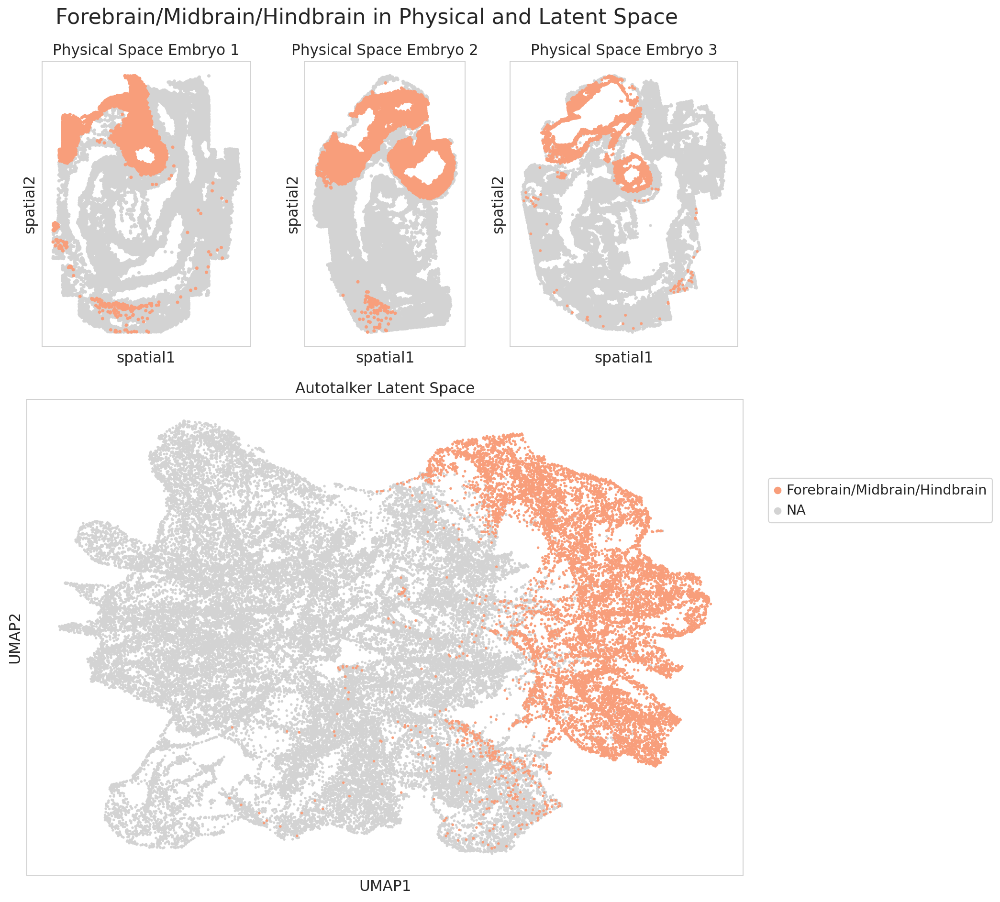

In [330]:
plot_physical_latent_for_cell_types(adata=model.adata,
                                    cell_types=[cell_type],
                                    sample_key=sample_key,
                                    cell_type_key=cell_type_key,
                                    cell_type_colors=seqfish_mouse_organogenesis_cell_type_colors,
                                    figure_folder_path=figure_folder_path,
                                    save_fig=True)

In [ ]:
top_unique_gps = get_differential_analysis_results(
    analysis_label=cell_type_fmt,
    model=model,
    adata=model.adata,
    cell_type_key=cell_type_key,
    cell_type_colors=cell_type_colors,
    latent_cluster_colors=latent_cluster_colors,
    cat_key=cell_type_key,
    selected_cats=[cell_type],
    differential_gp_scores_key=cell_type_differential_gp_scores_key,
    comparison_cats="rest",
    plot_category=cell_type_key,
    plot_group=cell_type,
    selected_gps=None,
    n_top_up_gps=10,
    n_top_down_gps=10,
    feature_spaces=["latent"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
    save_figs=True,
    figure_folder_path=figure_folder_path,
    random_seed=random_seed)

top_gps_summary_df = store_top_gps_summary(model=model,
                                           top_gps=top_unique_gps,
                                           file_path=f"{figure_folder_path}/{cell_type_fmt}_gp_summary.csv")
display(top_gps_summary_df)

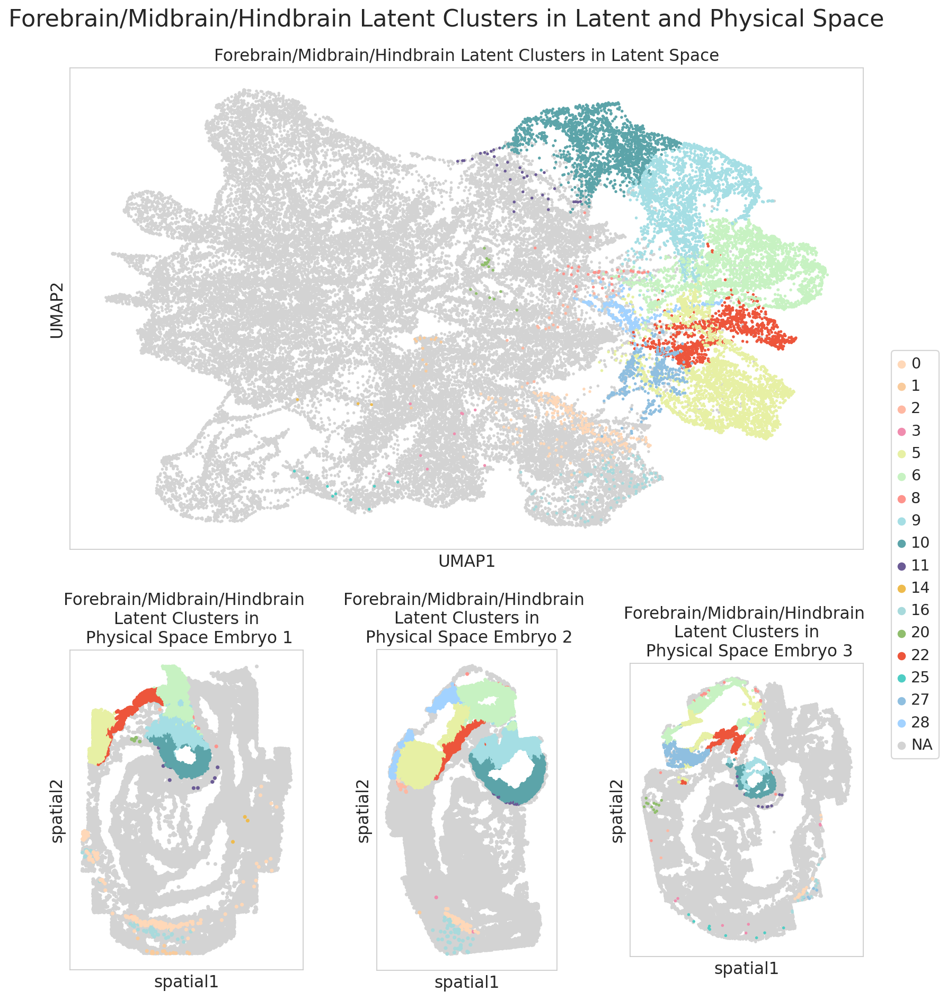

In [331]:
# All latent clusters
cluster_and_plot_cell_type_latent_clusters(adata=model.adata,
                                           cell_type_latent_resolution=cell_type_latent_resolution,
                                           cell_type_latent_cluster_key=cell_type_latent_cluster_key,
                                           latent_knng_key=latent_knng_key,
                                           cell_type_key=cell_type_key,
                                           cell_type=cell_type,
                                           groups=None,
                                           latent_cluster_colors=latent_cluster_colors,
                                           condition_key=sample_key,
                                           save_fig=True,
                                           figure_folder_path=figure_folder_path)

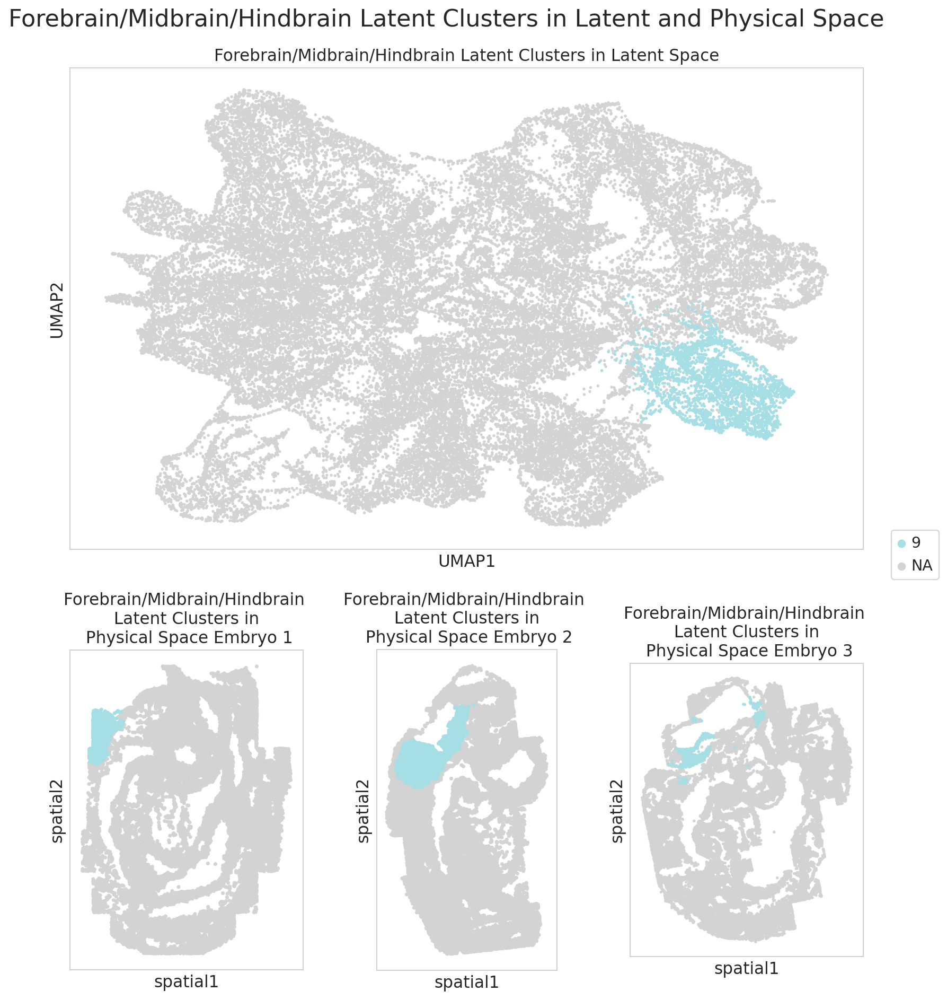

In [301]:
# Specific latent clusters
cluster_and_plot_cell_type_latent_clusters(adata=model.adata,
                                           cell_type_latent_resolution=cell_type_latent_resolution,
                                           cell_type_latent_cluster_key=cell_type_latent_cluster_key,
                                           latent_knng_key=latent_knng_key,
                                           cell_type_key=cell_type_key,
                                           cell_type=cell_type,
                                           groups="9",
                                           latent_cluster_colors=latent_cluster_colors,
                                           condition_key=sample_key,
                                           save_fig=True,
                                           figure_folder_path=figure_folder_path)

#### 3.2.3.2 Latent Cluster Analysis

In [336]:
# Retrieve all latent clusters with cells of the given cell type
cell_type_latent_clusters = [cell_type_latent_cluster for cell_type_latent_cluster 
                             in model.adata.obs[cell_type_latent_cluster_key].unique().tolist()
                             if str(cell_type_latent_cluster) != "nan"]

# Define latent clusters of interest according to visualization
cell_type_latent_clusters_of_interest = ["5", "6", "10", "22", "27", "28"]

# Add column with sub cell types
model.adata.obs[sub_cell_type_key] = model.adata.obs.apply(lambda row: add_sub_cell_type(row,
                                                                                         cell_type_key=cell_type_key,
                                                                                         cell_type=cell_type,
                                                                                         cell_type_latent_cluster_key=cell_type_latent_cluster_key), axis=1)
model.adata.obs[sub_cell_type_key] = model.adata.obs[sub_cell_type_key].astype("category")

# Squidpy nhood enrichment is sorted alphabetically
sub_cell_types = model.adata.obs[sub_cell_type_key].unique().tolist()
sub_cell_types.sort()

sq.gr.nhood_enrichment(model.adata, cluster_key=sub_cell_type_key)

cell_type_sub_cell_types_idx = []
for i, sub_cell_type in enumerate(sub_cell_types):
    if cell_type in sub_cell_type:
        cell_type_sub_cell_types_idx.append(i)

        # Retrieve cell type latent cluster neighborhood enrichments
enrichment_dict = {f"{sub_cell_types[cell_type_sub_cell_types_idx[i]]}":{
    sub_cell_type: zscore for zscore, sub_cell_type in sorted(
        zip(model.adata.uns[f"{sub_cell_type_key}_nhood_enrichment"]["zscore"][cell_type_sub_cell_types_idx[i]], sub_cell_types), reverse=True)} for i in range(len(cell_type_sub_cell_types_idx))}

enrichment_df = pd.DataFrame(enrichment_dict)

  0%|          | 0/1000 [00:00<?, ?/s]

,category,gene_program,p_h0,p_h1,log_bayes_factor
0,9,DKK1_ligand_receptor_GP,0.900631,0.099369,2.204253
1,9,NPW_ligand_receptor_GP,0.869702,0.130298,1.898325
2,9,RARRES1_ligand_receptor_GP,0.869505,0.130495,1.896589
3,9,WNT7B_ligand_receptor_GP,0.843586,0.156414,1.685154
4,9,PROK2_ligand_receptor_GP,0.835760,0.164240,1.627015
5,9,WNT8B_ligand_targetgenes_GP,0.835714,0.164286,1.626675
6,9,S100P_ligand_receptor_GP,0.828960,0.171040,1.578272
7,9,MYOC_ligand_receptor_GP,0.827522,0.172478,1.568163
8,9,COMPLEX:IL12B_IL23A_ligand_receptor_GP,0.815845,0.184155,1.488445
9,9,PCSK1N_ligand_receptor_GP,0.808251,0.191749,1.438682


,category,gene_program,p_h0,p_h1,log_bayes_factor
827,9,APP_ligand_targetgenes_GP,0.120287,0.879713,-1.989719
826,9,GDNF_ligand_receptor_GP,0.132130,0.867870,-1.882255
825,9,VEGFA_ligand_receptor_GP,0.146893,0.853107,-1.759183
824,9,EPO_ligand_receptor_GP,0.152686,0.847314,-1.713689
823,9,PSG5_ligand_receptor_GP,0.157520,0.842480,-1.676799
822,9,SFRP4_ligand_receptor_GP,0.160684,0.839316,-1.653149
821,9,DPP4_ligand_receptor_GP,0.162638,0.837362,-1.638727
820,9,CLDN14_ligand_receptor_GP,0.165066,0.834934,-1.621004
819,9,EDN2_ligand_receptor_GP,0.165376,0.834624,-1.618759
818,9,SFTPD_ligand_receptor_GP,0.167096,0.832904,-1.606347


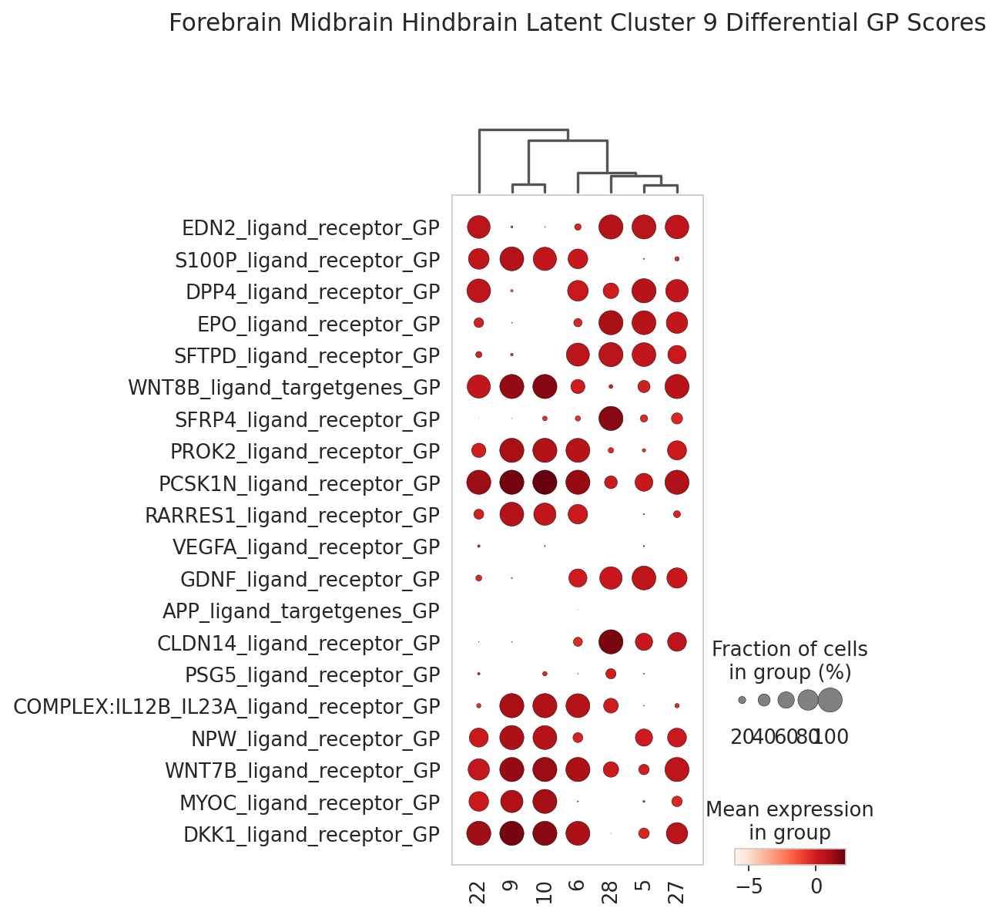

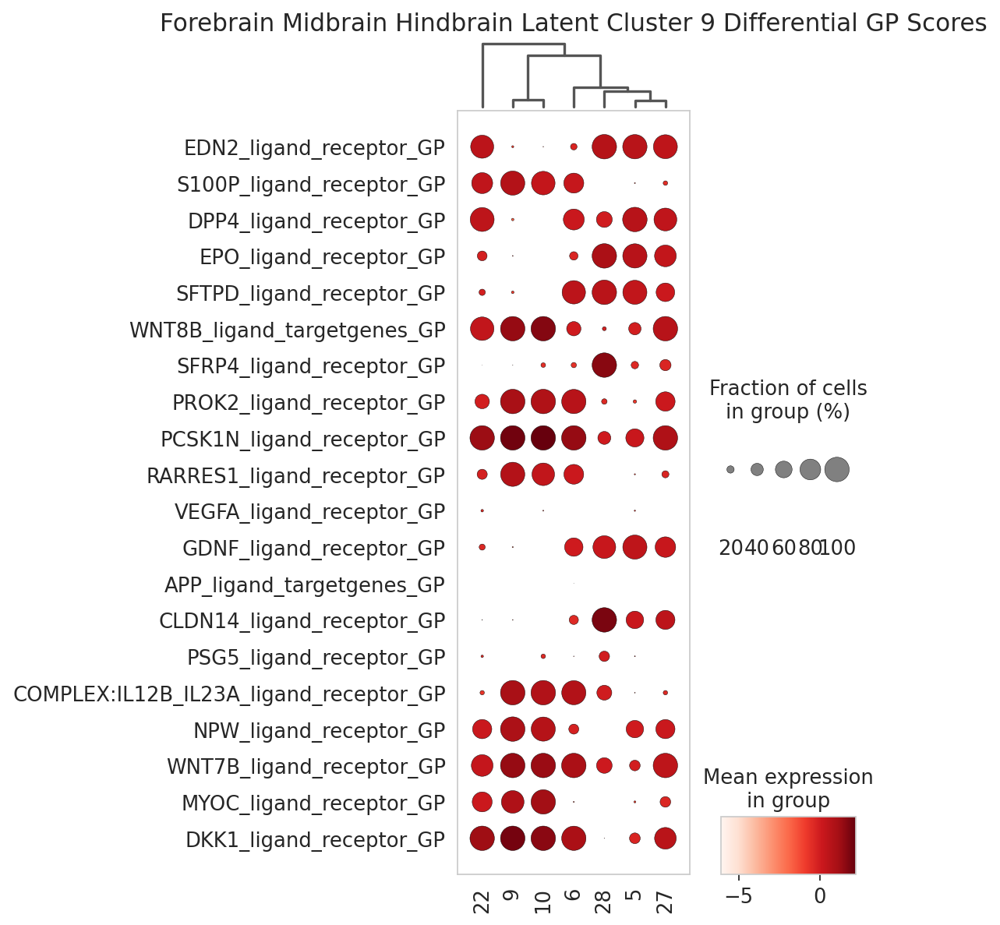

,gp_name,all_gp_idx,gp_active,active_gp_idx,n_source_genes,n_non_zero_source_genes,n_target_genes,n_non_zero_target_genes,gp_source_genes,gp_target_genes,gp_source_genes_weights_sign_corrected,gp_target_genes_weights_sign_corrected,gp_source_genes_importances,gp_target_genes_importances
68,NPW_ligand_receptor_GP,68,True,62,1,1,0,0,[Npw],[],[0.6201],[],[1.0],[]
110,VEGFA_ligand_receptor_GP,110,True,95,1,1,1,1,[Vegfa],[Limk1],[0.4402],[-0.3597],[0.5503],[0.4497]
215,PSG5_ligand_receptor_GP,215,True,185,0,0,1,1,[],[Tnfrsf12a],[],[1.0169],[],[1.0]
220,DKK1_ligand_receptor_GP,220,True,189,1,1,1,1,[Dkk1],[Lrp4],[0.7703],[0.0807],[0.9052],[0.0948]
252,EPO_ligand_receptor_GP,252,True,221,1,1,0,0,[Epo],[],[0.3212],[],[1.0],[]
271,DPP4_ligand_receptor_GP,271,True,232,1,1,1,1,[Dpp4],[Ada],[0.9173],[-0.2913],[0.759],[0.241]
317,GDNF_ligand_receptor_GP,317,True,269,1,1,1,1,[Gdnf],[Rbp1],[0.5331],[0.3814],[0.5829],[0.4171]
486,S100P_ligand_receptor_GP,486,True,406,0,0,1,1,[],[Ddah2],[],[0.1277],[],[1.0]
575,SFTPD_ligand_receptor_GP,575,True,466,1,1,1,1,[Sftpd],[Mbl2],[-0.0604],[0.8871],[0.0637],[0.9363]
578,CLDN14_ligand_receptor_GP,578,True,469,1,1,1,1,[Cldn14],[Cldn16],[1.1464],[0.2969],[0.7943],[0.2057]


In [ ]:
selected_cats = ["9"]
comparison_cats = list(set(cell_type_latent_clusters_of_interest) - set(selected_cats))
latent_cluster_differential_gp_scores_key = f"autotalker_latent_cluster_{selected_cats[0]}_differential_gp_scores"

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, cell_type_latent_cluster_key, selected_cats[0], comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

top_unique_gps = get_differential_analysis_results(
    analysis_label=f"{cell_type_fmt}_latent_cluster_{selected_cats[0]}",
    model=model,
    adata=model.adata,
    cell_type_key=cell_type_key,
    cell_type_colors=cell_type_colors,
    latent_cluster_colors=latent_cluster_colors,
    random_seed=random_seed,
    cat_key=cell_type_latent_cluster_key,
    selected_cats=selected_cats,
    differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
    comparison_cats=comparison_cats,
    plot_category=cell_type_latent_cluster_emphasis_key,
    plot_group=[x for x in model.adata.obs[cell_type_latent_cluster_emphasis_key].unique().tolist() if str(x) != "nan"],
    selected_gps=None,
    n_top_up_gps=10,
    n_top_down_gps=10,
    feature_spaces=["latent"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
    figure_folder_path=figure_folder_path,
    save_figs=True)

top_gps_summary_df = store_top_gps_summary(model=model,
                                           top_gps=top_unique_gps,
                                           file_path=f"{figure_folder_path}/{cell_type_fmt}_cluster_{selected_cats[0]}_gp_summary.csv")
display(top_gps_summary_df)

In [ ]:
# Retrieve all latent clusters with cells of the given cell type
cell_type_latent_clusters = [cell_type_latent_cluster for cell_type_latent_cluster 
                             in model.adata.obs[cell_type_latent_cluster_key].unique().tolist()
                             if str(cell_type_latent_cluster) != "nan"]

# Define latent clusters of interest according to visualization
cell_type_latent_clusters_of_interest = ["2", "25", "43"]

# Add column with sub cell types
model.adata.obs[sub_cell_type_key] = model.adata.obs.apply(lambda row: add_sub_cell_type(row, cell_type=cell_type), axis=1)
model.adata.obs[sub_cell_type_key] = model.adata.obs[sub_cell_type_key].astype("category")

# Squidpy nhood enrichment is sorted alphabetically
sub_cell_types = model.adata.obs[sub_cell_type_key].unique().tolist()
sub_cell_types.sort()

sq.gr.nhood_enrichment(model.adata, cluster_key=sub_cell_type_key)

cell_type_sub_cell_types_idx = []
for i, sub_cell_type in enumerate(sub_cell_types):
    if cell_type in sub_cell_type:
        cell_type_sub_cell_types_idx.append(i)

        # Retrieve cell type latent cluster neighborhood enrichments
enrichment_dict = {f"{sub_cell_types[cell_type_sub_cell_types_idx[i]]}":{
    sub_cell_type: zscore for zscore, sub_cell_type in sorted(
        zip(model.adata.uns[f"{sub_cell_type_key}_nhood_enrichment"]["zscore"][cell_type_sub_cell_types_idx[i]], sub_cell_types), reverse=True)} for i in range(len(cell_type_sub_cell_types_idx))}

enrichment_df = pd.DataFrame(enrichment_dict)

In [ ]:
selected_cats = [""]
comparison_cats = list(
    set(cell_type_adata.obs[cell_type_latent_cluster_key].unique()) - set(selected_cats))

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

In [ ]:
get_differential_analysis_results(analysis_label="forebrain_midbrain_hindbrain_latent_cluster",
                                  model=model,
                                  adata=model.adata,
                                  cat_key=cell_type_latent_cluster_key,
                                  selected_cats=selected_cats,
                                  differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
                                  comparison_cats=comparison_cats,
                                  plot_category=cell_type_latent_cluster_emphasis_key,
                                  selected_gps=None,
                                  n_top_up_gps=3,
                                  n_top_down_gps=3,
                                  feature_spaces=["physical_embryo2"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
                                  save_figs=False)

In [ ]:
model.compute_gp_gene_importances(selected_gp="GDF3_ligand_targetgenes_GP")

In [ ]:
selected_cats = ["7"]
comparison_cats = ["8"]

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

In [ ]:
get_differential_analysis_results(analysis_label="forebrain_midbrain_hindbrain_latent_cluster",
                                  model=model,
                                  adata=model.adata,
                                  cat_key=cell_type_latent_cluster_key,
                                  selected_cats=selected_cats,
                                  differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
                                  comparison_cats=comparison_cats,
                                  plot_category=cell_type_latent_cluster_emphasis_key,
                                  selected_gps=None,
                                  n_top_up_gps=3,
                                  n_top_down_gps=3,
                                  feature_spaces=["physical_embryo2"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
                                  save_figs=False)

#### Latent Cluster 1

In [ ]:
selected_cats = ["1"]
comparison_cats = ["0", "2", "3", "4"]

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

In [ ]:
get_differential_analysis_results(analysis_label="forebrain_midbrain_hindbrain_latent_cluster",
                                  model=model,
                                  adata=model.adata,
                                  cat_key=cell_type_latent_cluster_key,
                                  selected_cats=selected_cats,
                                  differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
                                  comparison_cats=comparison_cats,
                                  plot_category=cell_type_latent_cluster_emphasis_key,
                                  selected_gps=None,
                                  n_top_up_gps=3,
                                  n_top_down_gps=3,
                                  feature_spaces=["physical_embryo2"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
                                  save_figs=False)

#### Latent Cluster 2

In [ ]:
selected_cats = ["2"]
comparison_cats = ["0", "1", "3", "4"]

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

In [ ]:
get_differential_analysis_results(analysis_label="forebrain_midbrain_hindbrain_latent_cluster",
                                  model=model,
                                  adata=model.adata,
                                  cat_key=cell_type_latent_cluster_key,
                                  selected_cats=selected_cats,
                                  differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
                                  comparison_cats=comparison_cats,
                                  plot_category=cell_type_latent_cluster_emphasis_key,
                                  selected_gps=None,
                                  n_top_up_gps=3,
                                  n_top_down_gps=3,
                                  feature_spaces=["physical_embryo2"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
                                  save_figs=False)

#### Latent Cluster 3

In [ ]:
selected_cats = ["3"]
comparison_cats = ["0", "1", "2", "4"]

model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs.apply(
    lambda row: add_cell_type_latent_cluster_emphasis(row, comparison_cats), axis=1)
model.adata.obs[cell_type_latent_cluster_emphasis_key] = model.adata.obs[cell_type_latent_cluster_emphasis_key].astype("category")

In [ ]:
get_differential_analysis_results(analysis_label="forebrain_midbrain_hindbrain_latent_cluster",
                                  model=model,
                                  adata=model.adata,
                                  cat_key=cell_type_latent_cluster_key,
                                  selected_cats=selected_cats,
                                  differential_gp_scores_key=latent_cluster_differential_gp_scores_key,
                                  comparison_cats=comparison_cats,
                                  plot_category=cell_type_latent_cluster_emphasis_key,
                                  selected_gps=None,
                                  n_top_up_gps=3,
                                  n_top_down_gps=3,
                                  feature_spaces=["physical_embryo2"], # "physical_embryo1", "physical_embryo2", "physical_embryo3"
                                  save_figs=False)

### 3.4 Gut Tube

In [ ]:
cell_type = "Gut tube"
cell_type_latent_resolution = 0.04

In [ ]:
plot_physical_latent_for_cell_types(adata=model.adata,
                                    cell_types=[cell_type],
                                    save_fig=True)

In [ ]:
cell_type_adata = model.adata[model.adata.obs[cell_type_key] == cell_type.replace("_", " ").capitalize()]

In [ ]:
# Compute latent nearest neighbor graph for cell type only
sc.pp.neighbors(cell_type_adata,
                use_rep=latent_key,
                key_added=f"{cell_type}_latent_knng")

# Compute latent Leiden clustering for cell type
sc.tl.leiden(adata=cell_type_adata,
             resolution=cell_type_latent_resolution,
             random_state=random_seed,
             key_added=cell_type_latent_cluster_key,
             adjacency=cell_type_adata.obsp[f"{cell_type}_latent_knng_connectivities"])

# Use cell type latent space for UMAP generation
sc.tl.umap(cell_type_adata,
           neighbors_key=f"{cell_type}_latent_knng")

In [ ]:
model.adata.obs[cell_type_latent_cluster_key] = np.nan
model.adata.obs.loc[model.adata.obs[cell_type_key] == cell_type.replace("_", " ").capitalize(),
                    cell_type_latent_cluster_key] = cell_type_adata.obs[cell_type_latent_cluster_key]

In [ ]:
plot_latent_physical_for_cell_type_latent_clusters(adata=model.adata,
                                                   cell_type="mixed_mesenchymal_mesoderm",
                                                   save_fig=False)

Dorsal-ventral separation of esophageal and tracheal progenitor populations in the gut tube (not visible in scVI latent space).

Dorsal-ventral and rostral-caudal spatially resolved patterns of the midbrain and hindbrain region.

In [ ]:
model.adata.obsp["autotalker_recon_adj"] = model.get_recon_adj()

In [ ]:
att_weight_df = aggregate_obsp_matrix_per_cell_type(adata=model.adata,
                                                    obsp_key="autotalker_agg_alpha",
                                                    cell_type_key=cell_type_key,
                                                    agg_rows=True)

recon_adj_df = aggregate_obsp_matrix_per_cell_type(adata=model.adata,
                                                   obsp_key="autotalker_recon_adj",
                                                   cell_type_key=cell_type_key,
                                                   agg_rows=True)

adj_df = aggregate_obsp_matrix_per_cell_type(adata=model.adata,
                                             obsp_key="spatial_connectivities",
                                             cell_type_key=cell_type_key,
                                             agg_rows=True)

In [ ]:
create_cell_type_chord_plot_from_df(adata=model.adata,
                                    df=att_weight_df,
                                    title="Aggregation Module Cell Type Attention",
                                    link_threshold=.5,
                                    cell_type_key=cell_type_key,
                                    save_fig=True,
                                    save_path=f"{model_artifacts_folder_path}/circos.png")

### 3.5 CellRank